In [1]:
import os
# start the notebook in the root of the git repo, so that we can import our stuff
if os.getcwd().split('/')[-1] == 'notebooks':
    os.chdir('..')

from src.simulation.sim import *
from src.simulation.initsim import gen_prior_param, init_simulation
from src.cli.simulations import first_k_with_value_then_random, flist_to_str
from src.simulation.graphs import *
from src.simulation.runsim import run_ensemble, run_simulation, make_progress


(ipykernel_launcher.py:63060): Gtk-WARNING **: 14:07:24.345: Locale not supported by C library.
	Using the fallback 'C' locale.


In [2]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [3]:
import scipy as sp
import matplotlib as mpl

mpl.rcParams["figure.dpi"] = 300

from src.simulation.sim import *
from src.analyse.analyse import *
# import graph_tool as gt
import pandas as pd
import powerlaw as pl
import plotly.io as pio
from scipy.optimize import curve_fit
pio.renderers.default = 'notebook_connected'
import numpy as np
import matplotlib.pyplot as plt

In [4]:
from collections import namedtuple, defaultdict
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib as mpl
mpl.rcParams["figure.dpi"] = 300


Result = namedtuple('Result', ['partisans', "sims"])
Sim = namedtuple("Sim", ["asymptotic", "non_partisans_mean"])

In [5]:
n = 100
bias = 0.6           # theta0
partisan_mean = 0.3  # thetap
partisan_sd = 0.01

num_partisans = 1
disruption = num_partisans
max_steps = 10000
num_coins = 1
true_bias = bias
learning_rate = 0.25

frac_partisans = num_partisans / n


In [6]:
def gen_with_partisans(partisan_val, num_partisans, n, persuadable_range):
    val = first_k_with_value_then_random(partisan_val, num_partisans)
    return flist_to_str(gen_prior_param(val, n, range=persuadable_range))

sim_params = dict(
    prior= {
        "mean": gen_with_partisans(partisan_mean, num_partisans, n, persuadable_range=(0, 1)),
        "sd": gen_with_partisans(partisan_sd, num_partisans, n, persuadable_range=(0.2, 0.8)),
        "n": n,
        "mean_range": (0, 1),
        "sd_range": (0.2, 0.8),
    },
    max_steps= max_steps,
    true_bias= bias,
    tosses_per_iteration= 1,
    learning_rate= learning_rate,
    asymptotic_learning_max_iters= 99,
    DWeps= 1,
    disruption= 1,
    log= True,  # need to log to get mean_list
    coinslist= None,  # coin list needs to be None to have different simulations
    break_on_asymptotic_learning= False,
)

### Links

In [107]:

from src.simulation.graphs import gen_incomplete_link

sim = run_simulation(gen_incomplete_link([1,1]), **sim_params)

# fix the results -- namely some 
# things that should be np.array but are lists of np.array
results_dict = {k: v for k, v in zip(SimResults._fields, sim)}
from src.analyse.results import results_array_params
for k in results_array_params:
    results_dict[k] = np.asarray(results_dict[k])
sim = SimResults(**results_dict)

args = {
    "size": n,
    "bias": bias,
    "disruption": disruption,
}


In [108]:
friend_link= AnalyseSimulation(sim, args, sim_params, 0)

In [109]:
friend_link.dump()
# Wrote latest results to output/res-2023_02_21-09_43_13.json

Wrote latest results to output/res-2023_02_21-09_43_13.json


In [141]:
friend_link.calc_confidence_in_belief([0.6])[:,0,0]
agent_1_true = np.array(friend_link.calc_confidence_in_belief([0.6])[:,1])
agent_2_true = np.array(friend_link.calc_confidence_in_belief([0.6])[:,2])

np.greater(agent_1_true, agent_2_true).sum()


1

In [8]:

from src.simulation.graphs import gen_incomplete_link

sim = run_simulation(gen_incomplete_link([1,1,1]), **sim_params)

# fix the results -- namely some 
# things that should be np.array but are lists of np.array
results_dict = {k: v for k, v in zip(SimResults._fields, sim)}
from src.analyse.results import results_array_params
for k in results_array_params:
    results_dict[k] = np.asarray(results_dict[k])
sim = SimResults(**results_dict)

args = {
    "size": 4,
    "bias": bias,
    "disruption": disruption,
}
friend_link_4= AnalyseSimulation(sim, args, sim_params, 0)


In [13]:
for i in range(0,3):
    print(friend_link_4.calc_confidence_in_belief([0.6])[:,i] > friend_link_4.calc_confidence_in_belief([0.6])[:,i+1]) 


[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[False]
 [False]
 [False]
 ...
 [False]
 [False]
 [False]]
[[ True]
 [ True]
 [ True]
 ...
 [False]
 [False]
 [False]]


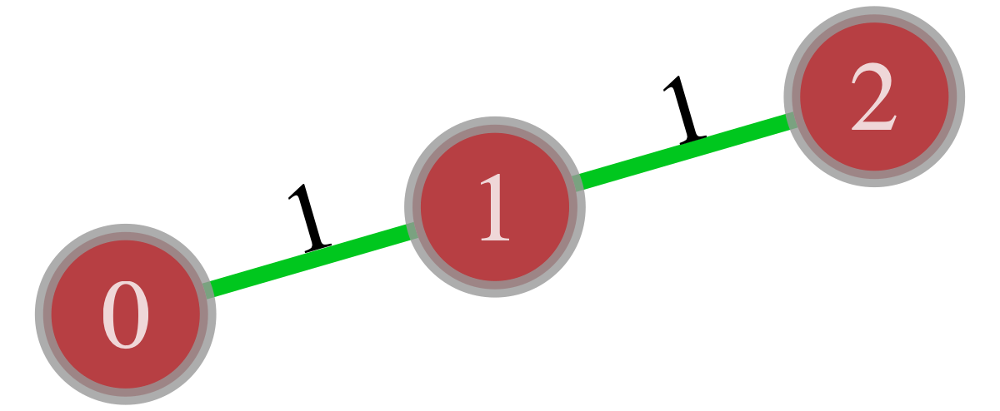

In [112]:
friend_link.show_graph()

In [9]:
friend_link_4.plotly_distr()

In [132]:
np.ndarray.flatten(friend_link.calc_confidence_in_belief([0.6])[:,1])

array([0.06189445, 0.06006819, 0.05076984, ..., 0.49436076, 0.5932903 ,
       0.66551433])

In [133]:
np.sum(np.ndarray.flatten(friend_link.calc_confidence_in_belief([0.6])[:,1]) >= 0.5)

3315

In [131]:
np.ndarray.flatten(friend_link.calc_confidence_in_belief([0.6])[:,2])

array([0.05042403, 0.06415655, 0.05805181, ..., 0.63467314, 0.74779382,
       0.82795895])

In [134]:
np.sum(np.ndarray.flatten(friend_link.calc_confidence_in_belief([0.6])[:,2]) >= 0.5)

5065

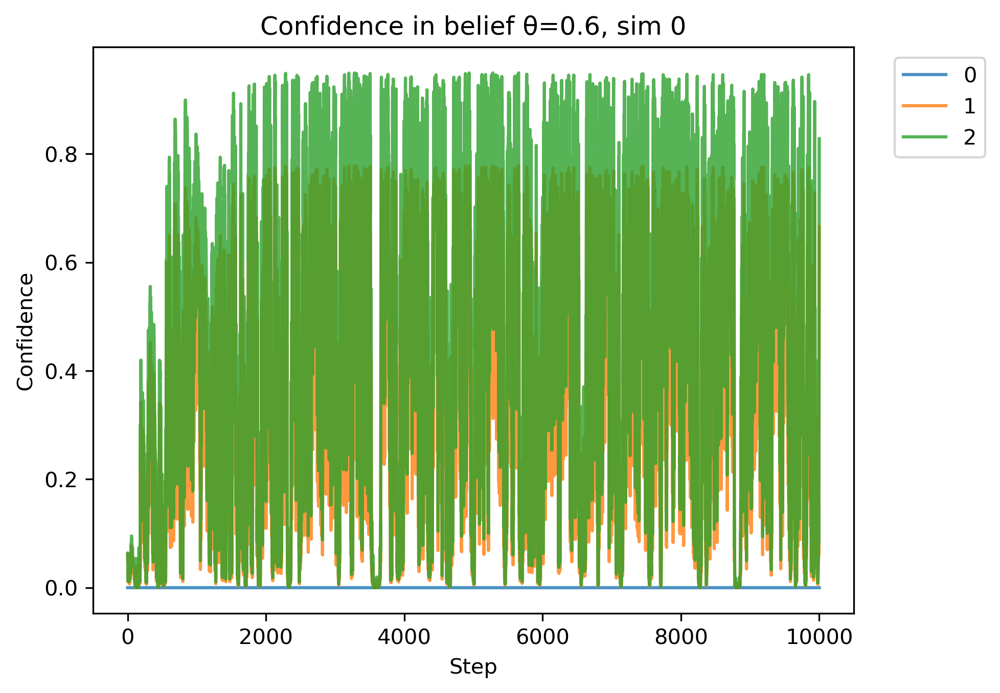

In [129]:
friend_link.plot_confidence_in_belief(0.6)

### Large BA networks with n = 100 and m = 3

In [ ]:
n = 100
bias = 0.6           # theta0
partisan_mean = 0.3  # thetap
partisan_sd = 0.01

num_partisans = 1
disruption = num_partisans
max_steps = 10000
num_coins = 1
true_bias = bias
learning_rate = 0.25

frac_partisans = num_partisans / n


In [17]:
def gen_with_partisans(partisan_val, num_partisans, n, persuadable_range):
    val = first_k_with_value_then_random(partisan_val, num_partisans)
    return flist_to_str(gen_prior_param(val, n, range=persuadable_range))

sim_params = dict(
    prior= {
        "mean": gen_with_partisans(partisan_mean, num_partisans, n, persuadable_range=(0, 1)),
        "sd": gen_with_partisans(partisan_sd, num_partisans, n, persuadable_range=(0.2, 0.8)),
        "n": n,
        "mean_range": (0, 1),
        "sd_range": (0.2, 0.8),
    },
    max_steps= max_steps,
    true_bias= bias,
    tosses_per_iteration= 1,
    learning_rate= learning_rate,
    asymptotic_learning_max_iters= 99,
    DWeps= 1,
    disruption= 1,
    log= True,  # need to log to get mean_list
    coinslist= None,  # coin list needs to be None to have different simulations
    break_on_asymptotic_learning= False,
)

In [7]:

from src.simulation.graphs import gen_bba_graph

sim = run_simulation(gen_bba_graph(100,3,lambda: 1 ), **sim_params)

# fix the results -- namely some 
# things that should be np.array but are lists of np.array
results_dict = {k: v for k, v in zip(SimResults._fields, sim)}
from src.analyse.results import results_array_params
for k in results_array_params:
    results_dict[k] = np.asarray(results_dict[k])
sim = SimResults(**results_dict)

args = {
    "size": 100,
    "bias": bias,
    "disruption": disruption,
}



In [8]:
BA_allies= AnalyseSimulation(sim, args, sim_params, 0)

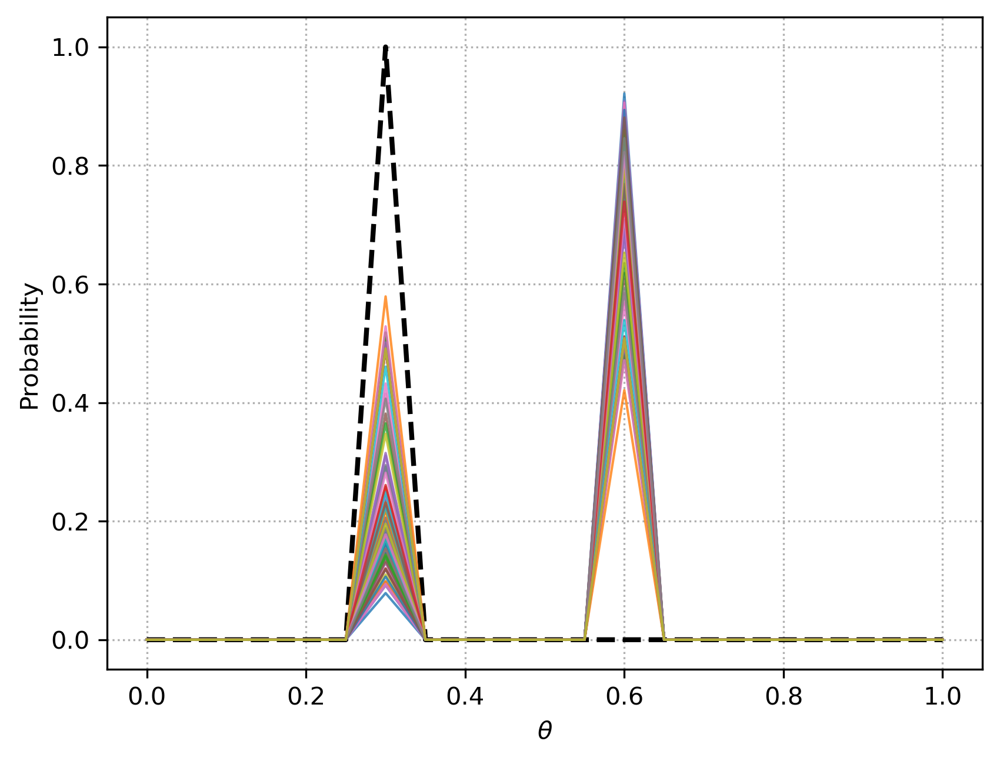

In [9]:
BA_allies.plot_distr(-1)

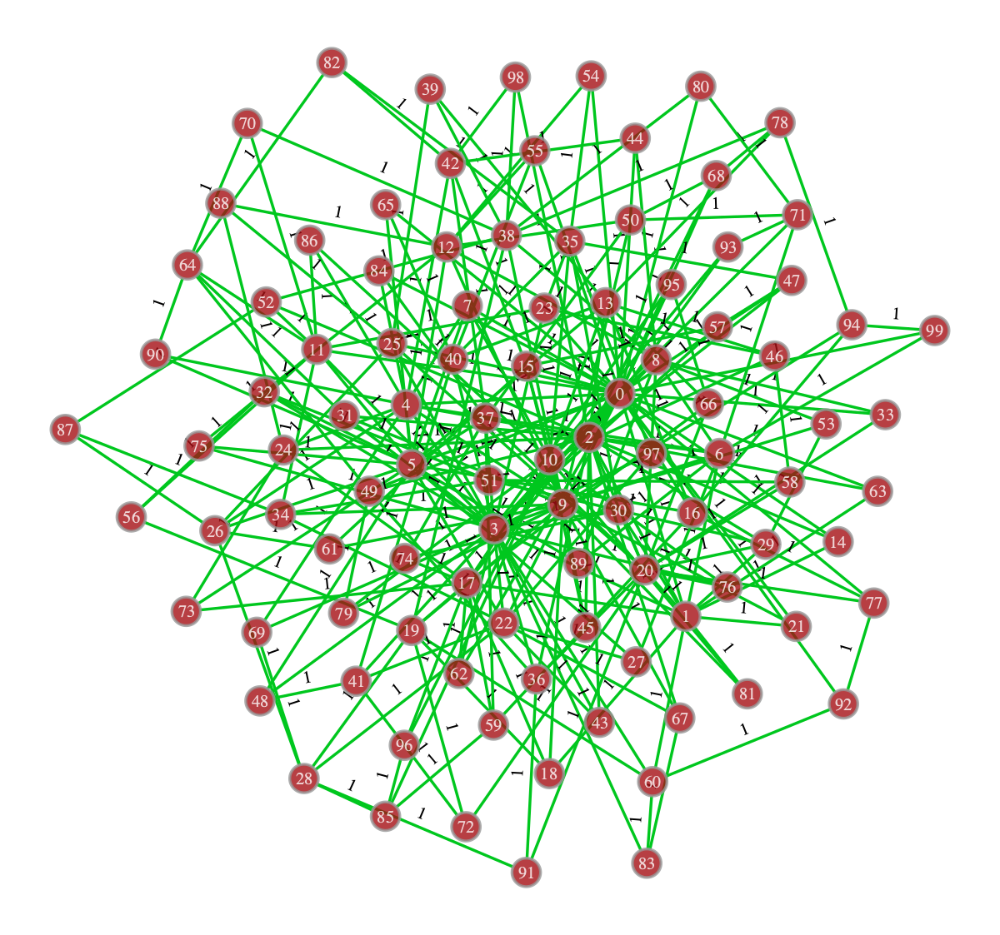

In [10]:
BA_allies.show_graph()

In [11]:
BA_allies.results.adjacency

array([[0., 1., 1., ..., 0., 0., 1.],
       [1., 0., 1., ..., 0., 0., 0.],
       [1., 1., 0., ..., 0., 1., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.]])

In [12]:
import graph_tool as gt

In [13]:
from graph_tool.search import dijkstra_search, dijkstra_iterator

from src.analyse.results import SimResults, read_graph

### BA Allies only 100 runs

In [ ]:
res_BA_allies = analyse_results("output/res-2023_02_21-15_21_03.json")

In [ ]:
np.sum(res_BA_allies[0].results.friendliness == 1)

In [ ]:
res_BA_allies[0].plot_all_mean(steps=100)

In [ ]:
# res = []
# for sim in res_BA_allies[:3]:
#     res.extend(sim.get_dist_and_step())

# flatten the first dimension
# res = np.array([sim.get_dist_and_step() for sim in res_BA_allies]).reshape(-1, 2)
# res.sort()"

In [ ]:
res1 = np.array([sim.get_dist_and_step() for sim in res_BA_allies])

In [ ]:
res1 = res1.reshape(-1, 2)

In [ ]:
df = pd.DataFrame(res1, columns=["distance", "step"])

In [ ]:
df = df.sort_values(by="distance")

In [ ]:
sns.boxplot(df, x = "distance", y = "step")

In [ ]:
df

In [ ]:
sum(df['distance'] ==0),sum(df['distance'] ==1),sum(df['distance'] ==2),sum(df['distance'] ==3),sum(df['distance'] ==4)

In [ ]:
sum(df['distance'] ==4)

Opponents only

In [ ]:

from src.simulation.graphs import gen_bba_graph

sim = run_simulation(gen_bba_graph(100,3,lambda: -1 ), **sim_params)

# fix the results -- namely some 
# things that should be np.array but are lists of np.array
results_dict = {k: v for k, v in zip(SimResults._fields, sim)}
from src.analyse.results import results_array_params
for k in results_array_params:
    results_dict[k] = np.asarray(results_dict[k])
sim = SimResults(**results_dict)

args = {
    "size": 100,
    "bias": bias,
    "disruption": disruption,
}

BA_opponents= AnalyseSimulation(sim, args, sim_params, 0)

In [ ]:
BA_opponents.plot_all_mean()

In [ ]:
BA_opponents.plot_distr(-1)

Mixed

In [ ]:

from src.simulation.graphs import gen_bba_graph_mixed

sim = run_simulation(gen_bba_graph_mixed(100,3), **sim_params)

# fix the results -- namely some 
# things that should be np.array but are lists of np.array
results_dict = {k: v for k, v in zip(SimResults._fields, sim)}
from src.analyse.results import results_array_params
for k in results_array_params:
    results_dict[k] = np.asarray(results_dict[k])
sim = SimResults(**results_dict)

args = {
    "size": 100,
    "bias": bias,
    "disruption": disruption,
}

BA_mixed= AnalyseSimulation(sim, args, sim_params, 0)

In [ ]:
BA_mixed.show_graph()

In [ ]:
BA_mixed.agent_t_A()

In [ ]:
learnt, = np.where(BA_mixed.agent_t_A() != 10000)
learnt[30:]

In [ ]:
BA_mixed.plot_all_mean()

In [ ]:
BA_mixed.plot_distr(-1)

In [ ]:
# be careful when running this, it will cost 100MB
BA_mixed.plotly_distr(steps=range(0, 10000, 10))